<a href="https://colab.research.google.com/github/DavidRand75/sandra_preprocessing/blob/main/Sandra_v1_01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import

In [ ]:
import numpy as np
import pandas as pd
import os
from glob import glob
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import product
from scipy.signal import decimate, find_peaks, resample
from scipy.signal import spectrogram, welch, butter, filtfilt, freqz, iirnotch, sosfiltfilt, sosfreqz, decimate#, iircomb
from scipy import signal, fftpack

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install PyWavelets
import pywt

In [ ]:
!pip install noisereduce
import noisereduce as nr

In [ ]:
#install pydub for importing audio files
!pip install pydub
from pydub import AudioSegment

# Functions

In [ ]:
# @title plot_sig

def plot_sig(signal, fs, title, xmin='min',
             xmax='max', ymin='min', ymax='max',
             additional_df=None, figsize=(10, 10),save_path = False):

    time_v = np.arange(len(signal)) / fs

    if xmax == 'max':
        xmax = max(time_v)
    if xmin == 'min':
        xmin = min(time_v)

    # Determine the number of subplots
    num_subplots = len(signal.columns)

    if additional_df is not None:
        num_subplots += 1

    fig, axs = plt.subplots(nrows=num_subplots, ncols=1, figsize=figsize)
    axs = np.atleast_1d(axs)

    for i, (column_label, column_data) in enumerate(signal.items()):
        axs[i].plot(time_v, column_data, linewidth=0.5)
        axs[i].set_xlabel('Time (s)')
        axs[i].set_ylabel('Amplitude')
        axs[i].set_title(column_label)
        axs[i].set_xlim(xmin=xmin, xmax=xmax)
        if ymin != 'min' and ymax != 'max':
            axs[i].set_ylim(ymin=ymin, ymax=ymax)

    # Plot additional_df if provided
    if additional_df is not None:
        time_column = additional_df.columns[0]
        data_column = additional_df.columns[1]
        axs[-1].plot(additional_df[time_column], additional_df[data_column], linewidth=0.5, color='r')
        axs[-1].set_xlabel(time_column)
        axs[-1].set_ylabel(data_column)
        axs[-1].set_title(f'{data_column} vs {time_column}')
        if xmax == 'max':
          xmax = max(time_column)
        if xmin == 'min':
          xmin = min(time_column)
        axs[-1].set_xlim(xmin=xmin, xmax=xmax)


    plt.tight_layout()
    fig.suptitle(title)
    plt.show()

    if save_path is not False:
      fig.savefig(os.path.join(save_path, title+'_plot.jpg'))

In [ ]:
# @title hilbert_envelope

def hilbert_envelope(signal, N = None):
  if N is None:
    N = len(signal)

  # Apply the Hilbert transform to get the analytic signal
  analytic_signal = hilbert(signal, N)
  # The envelope is the magnitude of the analytic signal
  envelope = np.abs(analytic_signal)
  return envelope

In [ ]:
# @title bandpass_filter

def bandpass_filter(df, lowcut, highcut, fs, order, notch=False, plot=False, xmax = None):
    if isinstance(df, pd.Series):
        df = df.to_frame()

    nyquist_freq = 0.5 * fs
    low = lowcut / nyquist_freq
    high = highcut / nyquist_freq

    # Validate frequencies
    if low >= high:
        raise ValueError("Lowcut frequency must be lower than highcut frequency.")
    if low <= 0 or high >= 1:
        raise ValueError("Lowcut and highcut frequencies must be between 0 and Nyquist frequency.")

    # Design bandpass filter using second-order sections
    sos = butter(order, [low, high], btype='band', output='sos')

    # Apply bandpass filter using sosfiltfilt for better numerical stability
    df_filt = pd.DataFrame()
    for column in df:
        df_filt[column] = sosfiltfilt(sos, df[column])

    # Bandpass filter frequency response using sosfreqz
    w_bp, h_bp = sosfreqz(sos, worN=fs)
    frequency_bp = (nyquist_freq / np.pi) * w_bp

    freq_response_fig = None

    if notch:
        # Adjust notch frequency calculation for stability
        notch_freq = 50  # Notch frequency in Hz
        q = 120  # Quality factor for the notch filter, adjusted for stability
        w0 = notch_freq / (fs / 2)  # Normalized frequency

        # Design notch filter
        b, a = iirnotch(w0, q)
        sos_notch = np.array([[b[0], b[1], b[2], 1, a[0], a[1]]])

        # Apply notch filter using sosfiltfilt for better numerical stability
        for column in df_filt:
            df_filt[column] = sosfiltfilt(sos_notch, df_filt[column])

        w_notch, h_notch = freqz(b,a, worN=fs)
        # Combined frequency response
        h_comb = h_bp * h_notch

        if plot:
            # Plot combined frequency response
            freq_response_fig = plt.figure(figsize=(10, 3))
            plt.plot(frequency_bp, 20 * np.log10(abs(h_comb + 1e-10)))
            plt.title("Combined Bandpass and Comb Filter Frequency Response")
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Gain (dB)')
            plt.xticks(np.arange(0, max(frequency_bp), 25))
            plt.grid()

            # Add horizontal line at -3 dB
            plt.axhline(y=-3, color='r', linestyle='--')

    else:
        if plot:
            # Plot bandpass frequency response
            freq_response_fig = plt.figure(figsize=(10, 3))
            plt.plot(frequency_bp, 20 * np.log10(abs(h_bp)), 'b')
            plt.title("Butterworth Bandpass Filter Frequency Response")
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Gain (dB)')
            plt.grid()

            # Add horizontal line at -3 dB
            plt.axhline(y=-3, color='r', linestyle='--')


    if plot:
        plt.ylim(-30, 1)
        if xmax == None:
          plt.xlim(0, highcut + highcut * 0.1)
        else:
          plt.xlim(0, xmax)
        plt.yticks(np.arange(-30, 3, step=3))
        return
    else:
        return df_filt


In [ ]:
# @title wavelet_denoising

def soft_thresholding(coefficients, threshold):
    return np.sign(coefficients) * np.maximum(np.abs(coefficients) - threshold, 0)

def wavelet_denoising(signal, threshold, wavelet='db4', level=None, ):
    """
    Performs wavelet denoising on the input signal.

    Args:
        signal: 1D numpy array containing the signal to be denoised.
        wavelet: The type of wavelet to use. Default is 'db4'.
        level: The number of decomposition levels. Default is 1.

    Returns:
        The denoised signal as a 1D numpy array.
    """

    # Perform wavelet decomposition
    coefficients = pywt.wavedec(signal, wavelet, level = level)

    # Apply thresholding to detail coefficients

    threshold = np.percentile(np.abs(np.concatenate(coefficients)), threshold)
    # Apply soft thresholding
    soft_thresholded_coefficients = [soft_thresholding(c, threshold) for c in coefficients]
    # Reconstruct the denoised signal
    # Perform inverse DWT
    denoised_signal = pywt.waverec(soft_thresholded_coefficients, wavelet)

    return denoised_signal[:signal.shape[0]]

In [ ]:
# @title smoothed_signal
def smoothed_signal(signal, window_size, iterations, fs):
  window = int(fs * window_size / 1000) # im ms
  demeaned = signal - signal.mean()
  rectified = demeaned.abs()
  smoothed = rectified
  for _ in range(iterations):
    smoothed = smoothed.rolling(window=window).mean()
  return smoothed.fillna(0)

In [ ]:
# @title plt.spectogram
def plt_spectrogram(signal, fs, title, save_path, nfft=1024, vmin=None, vmax=None, save = False):
  f = plt.figure(figsize=(10, 6))

  Pxx, freqs, bins, im = plt.specgram(signal, Fs=fs, NFFT=nfft, noverlap=int(nfft/4), scale='dB', vmin=vmin, vmax=vmax, cmap='viridis')
  Pxx = np.where(Pxx == 0, 1e-10, Pxx)
  plt.xlim(0, max(bins))
  plt.colorbar(im, label='dB/Hz')

  # Set labels and title
  plt.ylabel('Frequency (Hz)')
  plt.xlabel('Time (s)')
  plt.title(title)


  plt.show()

  if save:
    f.savefig(os.path.join(save_path,title+'_spectogram.jpg'))

  return Pxx, freqs, bins, im

In [ ]:
# @title spectograma
def spectrograma(signal, fs, title, save_path, nfft=1024, vmin=None, vmax=None, save=False):
    f = plt.figure(figsize=(10, 6))

    # Compute the spectrogram using scipy
    freqs, bins, Sxx = spectrogram(signal, fs=fs, nperseg=nfft, noverlap=int(nfft / 4))

    # Convert to dB scale, apply a threshold to avoid log(0)
    Sxx = 10 * np.log10(np.maximum(Sxx, 1e-10))  # Replace zero or negative values with 1e-10

    # Plot the spectrogram
    im = plt.pcolormesh(bins, freqs, Sxx, shading='gouraud', cmap='viridis', vmin=vmin, vmax=vmax)
    plt.colorbar(im, label='dB/Hz')

    # Set plot limits, labels, and title
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.title(title)
    plt.xlim(0, max(bins))

    # Show the plot
    plt.show()

    # Save the figure if requested
    if save:
        f.savefig(os.path.join(save_path, title + '_spectogram.jpg'))

    return Sxx, freqs, bins, im


In [ ]:
# @title Create audio dataframe
def audio_dataframe(audio_file,respiration_file=None, file_path=None):

  audio = AudioSegment.from_file(audio_file)
  raw_data = audio.raw_data
  channels = audio.channels
  sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
  sampling_rate = audio.frame_rate
  audio_array = np.frombuffer(raw_data, dtype=np.int16)

  time_v = np.arange(len(audio_array)) / sampling_rate
  audio_data = pd.DataFrame({'time': time_v,'raw_data': audio_array})

  audio_data['filtered'] = bandpass_filter(audio_data['raw_data'],lowcut = 70, highcut = 5000, fs = sampling_rate, order = 6)
  audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold = 99 )
  audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs = sampling_rate, window_size=50, iterations=4)

  if respiration_file:
    respiration_data = pd.read_csv(respiration_file)
    audio_data['Respiration'] = np.interp(audio_data.time,respiration_data['Data Set 1:Time(s)'],respiration_data['Data Set 1:Force(N)'] )

  if file_path:
    filename = audio_file.split('/')[-1].split('.')[0]
    audio_data.to_csv(os.path.join(file_path, filename+'.csv' ))

  return audio_data, sampling_rate

In [ ]:
import librosa

# @title Create audio dataframe librosa
def audio_dataframe_lib(audio_file, respiration_file=None, file_path=None, target_sampling_rate=16000):

    # Load the audio file using pydub
    audio = AudioSegment.from_file(audio_file)
    raw_data = audio.raw_data
    channels = audio.channels
    sample_width = audio.sample_width  # sample resolution = sample_width * 8 (1 = 8bit, 2 = 16 bit, etc.)
    original_sampling_rate = audio.frame_rate
    print(f'Original Sapling Rate = {original_sampling_rate}')
    print(f'Target Sapling Rate = {target_sampling_rate}')
    audio_array = np.frombuffer(raw_data, dtype=np.int16)

    # Downsample the audio array to the target sampling rate using librosa
    if original_sampling_rate != target_sampling_rate:
        # librosa expects mono audio, so reshape if necessary
        if channels > 1:
            audio_array = audio_array.reshape((-1, channels))
            audio_array = audio_array.mean(axis=1)  # Convert to mono by averaging channels

        # Resample the audio
        audio_array = librosa.resample(audio_array.astype(np.float32), orig_sr=original_sampling_rate, target_sr=target_sampling_rate)
        sampling_rate = target_sampling_rate
    else:
        sampling_rate = original_sampling_rate

    # Recalculate time vector based on the new (or unchanged) sampling rate
    time_v = np.arange(len(audio_array)) / sampling_rate

    # Create the dataframe
    audio_data = pd.DataFrame({'time': time_v, 'raw_data': audio_array})

    # Apply filtering and processing steps
    audio_data['filtered'] = bandpass_filter(audio_data['raw_data'], lowcut=70, highcut=5000, fs=sampling_rate, order=6)
    audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold=99)
    audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs=sampling_rate, window_size=50, iterations=4)

    # Handle respiration data if provided
    if respiration_file:
        respiration_data = pd.read_csv(respiration_file)
        audio_data['Respiration'] = np.interp(audio_data.time, respiration_data['Data Set 1:Time(s)'], respiration_data['Data Set 1:Force(N)'])

    # Save the dataframe to CSV if a file path is provided
    if file_path:
        filename = audio_file.split('/')[-1].split('.')[0]
        audio_data.to_csv(os.path.join(file_path, filename + '.csv'))

    return audio_data, sampling_rate


In [ ]:
# @title Respiration Shift
def respiration_shift(audio_df,fs, title, save_path, distance=0,width=0):

  a=audio_df.wavelet_smoothed.values
  b=audio_df.Respiration.values
  y = signal.correlate(b,a)
  t = np.arange(-a.shape[0],a.shape[0]-1)/fs
  p = find_peaks(y,distance=distance,width=width)[0]

  shift = t[p[np.argmin(np.abs(t[p]))]] #np.min((np.abs(np.argmax(signal.correlate(a,b)) - a.shape[0]),np.abs(np.argmax(signal.correlate(b,a)) - a.shape[0])))

  return audio_df.time.values-shift

In [ ]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
# @title audio_fig
def audio_fig(audio_df, process_stage, fs, title, save_path, nfft=1024, vmin=None, vmax=None, save=False):
    # Create a figure with two horizontal subplots (1 row, 2 columns)
    audio_sig = audio_df[process_stage]
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

    # Plot the line graphs in the second subplot (ax2)
    ax1_1 = ax1.twinx()  # Second y-axis
    sns.lineplot(ax=ax1, data=audio_df, x='time', y='wavelet')
    sns.lineplot(ax=ax1_1, data=audio_df, x='time', y='Respiration', color='black', label='Respiration')
    sns.lineplot(ax=ax1_1, data=audio_df, x='Respiration_time', y='Respiration', color='red', label='Respiration (shifted)').set(title=title)

    # Set labels for the second plot

    ax1.set_ylabel('Amplitude')
    ax1_1.set_ylabel('Respiration')

    # Compute the spectrogram using scipy
    freqs, bins, Sxx = spectrogram(audio_sig, fs=fs, nperseg=nfft, noverlap=int(nfft / 4))

    # Convert to dB scale, apply a threshold to avoid log(0)
    Sxx = 10 * np.log10(np.maximum(Sxx, 1e-10))  # Replace zero or negative values with 1e-10

    if process_stage == 'raw_data':
      freq_mask = freqs <= fs/2*(0.9)
      filtered_Sxx = Sxx[freq_mask, :]
    else:
      freq_mask = (freqs <= 5000) & (freqs >= 70)
      filtered_Sxx = Sxx[freq_mask, :]

    if vmin is None:
        vmin = np.min(filtered_Sxx)
    if vmax is None:
        vmax = np.max(filtered_Sxx)


    # Plot the spectrogram in the first subplot (ax1)
    im = ax2.pcolormesh(bins, freqs, Sxx, shading='gouraud', cmap='viridis', vmin=vmin, vmax=vmax)
    if process_stage == 'raw_data':
      ax2.set_ylim(0, fs/2*(0.9))
    else:
      ax2.set_ylim(70, 5000)

    plt.colorbar(im, ax=ax2, label='dB/Hz', orientation='horizontal', fraction=.06)

    # Set plot limits, labels, and title for the spectrogram
    ax2.set_xlabel('Time (s)')
    ax2.set_ylabel('Frequency (Hz)')
    ax2.set_title('Spectrogram')

    min_time = min(audio_df['time'].min(), min(bins))
    max_time = max(audio_df['time'].max(), max(bins))
    ax1.set_xlim(min_time, max_time)
    ax2.set_xlim(min_time, max_time)

    # Adjust layout
    plt.tight_layout()

    # Show the combined plot
    plt.show()

    # Save the figure if requested
    if save:
        fig.savefig(os.path.join(save_path, title + '_combined_spectrogram_lineplot.jpg'))

    return Sxx, freqs, bins, im


# Analyse - Acoustic Room

## Run through all data

In [ ]:
mounted_path = '/content/drive/MyDrive/Work/Sandra/SANDRA Main Folder/'
desktop_path = 'G:/.shortcut-targets-by-id\1-60UWQcJjlcUEY9dtXC1esQ-nm2ZCZwK'

data_path = 'Sandra R&D/Data/Open Recordings /Second Pilot - acoustic room/Data'

subjects = ['Itai','Maor','David']
distances = [2.5,5,10,20]
resps = ['shallow','deep']


In [ ]:
snr = pd.DataFrame(list(product(subjects, distances, resps)),columns=['Subject','Distance','Level'])
snr[['mean','std']]=np.nan
snr.head()

,Subject,Distance,Level,mean,std
0,Itai,2.5,shallow,NaN,NaN
1,Itai,2.5,deep,NaN,NaN
2,Itai,5.0,shallow,NaN,NaN
3,Itai,5.0,deep,NaN,NaN
4,Itai,10.0,shallow,NaN,NaN


In [ ]:
subjects = ['Itai','Maor','David']
distances = [2.5,5,10,20]
resps = ['shallow','deep']

# @title create acoustic room audio files df
'''
creat a audio dictionary containing dfs of all the audio files with cols of differnt procerssing stages
'''

audio_dict = {}
for subject in subjects:
    folders = os.listdir(os.path.join(mounted_path,data_path,subject))
    audio_dict[subject] = {}
    for distance in distances:
      audio_dict[subject][distance] = {}
      folder = folders[[i for i in range(len(folders)) if '('+str(distance)+'cm)' in folders[i]][0]]
      audio_files = glob(os.path.join(mounted_path,data_path,subject,folder,'*cm.m*'))
      respiration_files = glob(os.path.join(mounted_path,data_path,subject,folder,'*.csv'))
      for resp in ['shallow','deep']:
        audio_dict[subject][distance][resp] = {}
        try:
          # Find audio file
          try:
            af = [f for f in audio_files if resp in f.split('\\')[-1].lower()][0]
          except IndexError:
              print(f"Audio file for {t} not found.")

          # Find respiration file
          try:
            rf = [f for f in respiration_files if resp in f.split('\\')[-1].lower()][0]

            # Sync respiration by crosscorrelation
            audio_data, sampling_rate = audio_dataframe_lib(af, rf)  # This will run even if rf is None
            audio_data['Respiration_time'] = respiration_shift(audio_data, sampling_rate,
                                                               title=' '.join([subject, str(distance) + 'cm', resp]),
                                                               save_path=os.path.join(mounted_path, data_path, 'Figures'),
                                                               distance=sampling_rate,
                                                               width=sampling_rate - 8,
                                                               )
          except IndexError:
              print(f"Respiration file for {t} not found.")
              rf = None  # Set to None if respiration file is not found

          audio_dict[subject][distance][resp] = audio_data


          #snr.loc[(snr.Subject == subject) & (snr.Distance == distance) & (snr.Level == t), 'mean'] = np.mean(sp[0].mean(axis=0))
          #snr.loc[(snr.Subject == subject) & (snr.Distance == distance) & (snr.Level == t), 'std'] = np.std(sp[0].mean(axis=0))

        except Exception as e:
          print(f"Unexpected error occurred: {e}")

Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 44100
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapling Rate = 48000
Target Sapling Rate = 16000
Original Sapli

In [ ]:
audio_dict['David'][2.5]['shallow']

,time,raw_data,filtered,wavelet,wavelet_smoothed,Respiration,Respiration_time
0,0.000000,0.000000,0.000718,0.0,0.000000,1.163239,0.092063
1,0.000063,0.000000,0.000644,0.0,0.000000,1.163163,0.092125
2,0.000125,0.000000,0.000568,0.0,0.000000,1.163088,0.092188
3,0.000188,0.000000,0.000491,0.0,0.000000,1.163013,0.092250
4,0.000250,0.000000,0.000412,0.0,0.000000,1.162938,0.092313
...,...,...,...,...,...,...,...
325286,20.330375,-0.556982,0.389205,0.0,0.006019,1.909294,20.422438
325287,20.330437,-0.165669,0.452231,0.0,0.006019,1.909294,20.422500
325288,20.330500,-0.303521,0.554604,0.0,0.006019,1.909294,20.422563
325289,20.330562,-0.202710,0.465631,0.0,0.006019,1.909294,20.422625


In [ ]:
audio_dict['Itai'].keys()

dict_keys([2.5, 5, 10, 20])

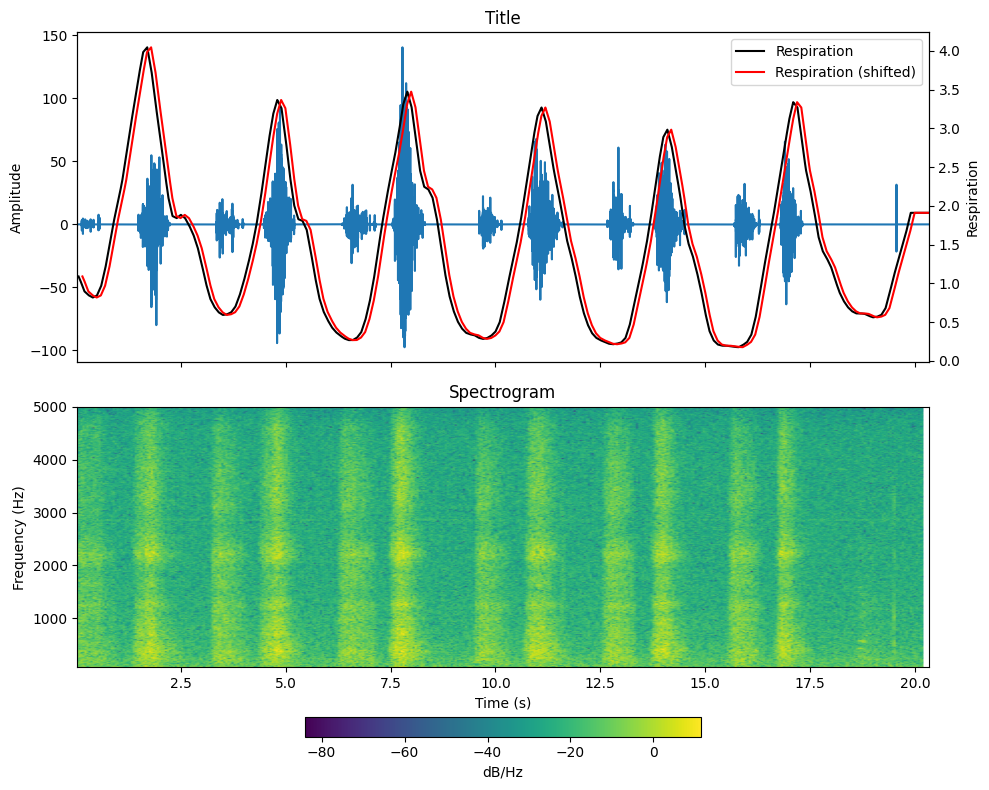

In [ ]:
audio_df = audio_dict['David'][2.5]['deep'][1000:]
x = audio_fig(audio_df,
              process_stage='filtered',
              fs=sampling_rate,
              title='Title',
              save_path=os.path.join(mounted_path, data_path, 'Figures'),
              nfft=1024,
              vmin=None,
              vmax=None,
              save=False)

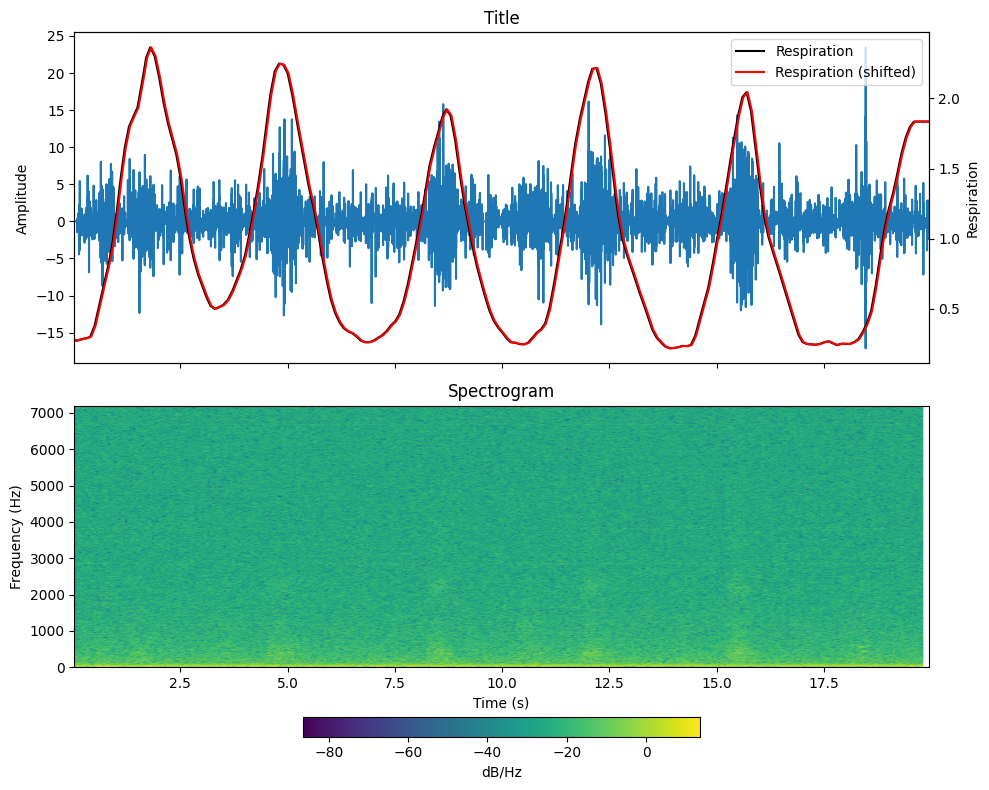

In [ ]:
audio_df = audio_dict['David'][2.5]['shallow'][1000:]
x = audio_fig(audio_df,
              process_stage='raw_data',
              fs=sampling_rate,
              title='Title',
              save_path=os.path.join(mounted_path, data_path, 'Figures'),
              nfft=1024,
              vmin=None,
              vmax=None,
              save=False)

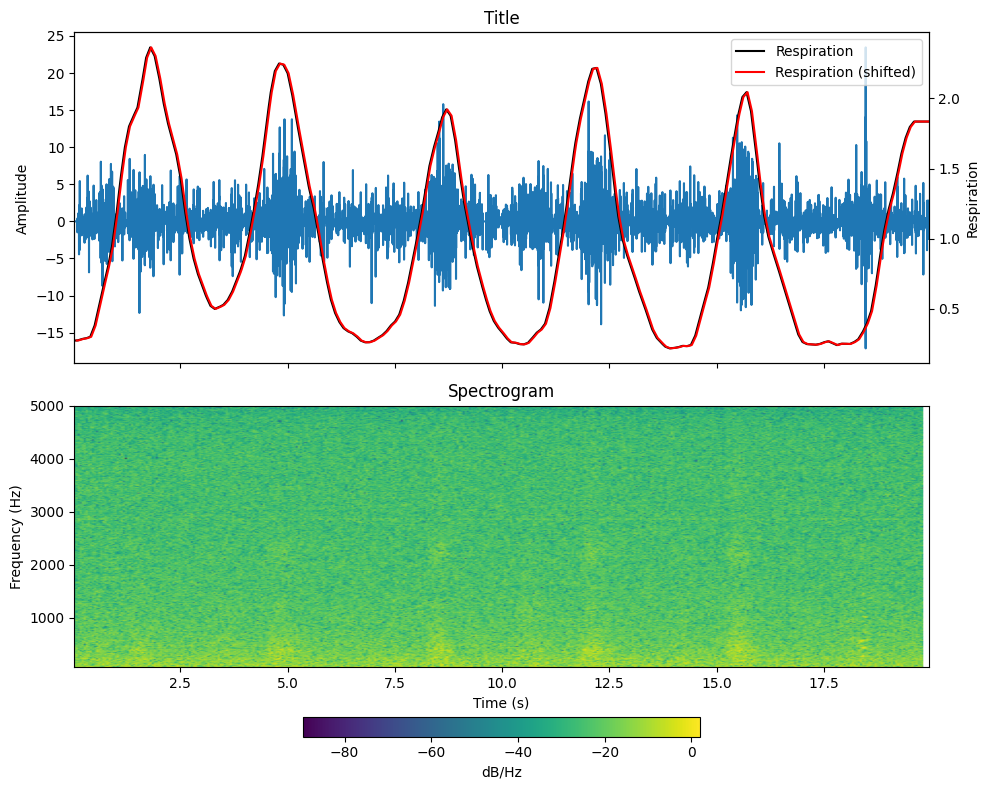

In [ ]:
audio_df = audio_dict['David'][2.5]['shallow'][1000:]
x = audio_fig(audio_df,
              process_stage='filtered',
              fs=sampling_rate,
              title='Title',
              save_path=os.path.join(mounted_path, data_path, 'Figures'),
              nfft=1024,
              vmin=None,
              vmax=None,
              save=False)

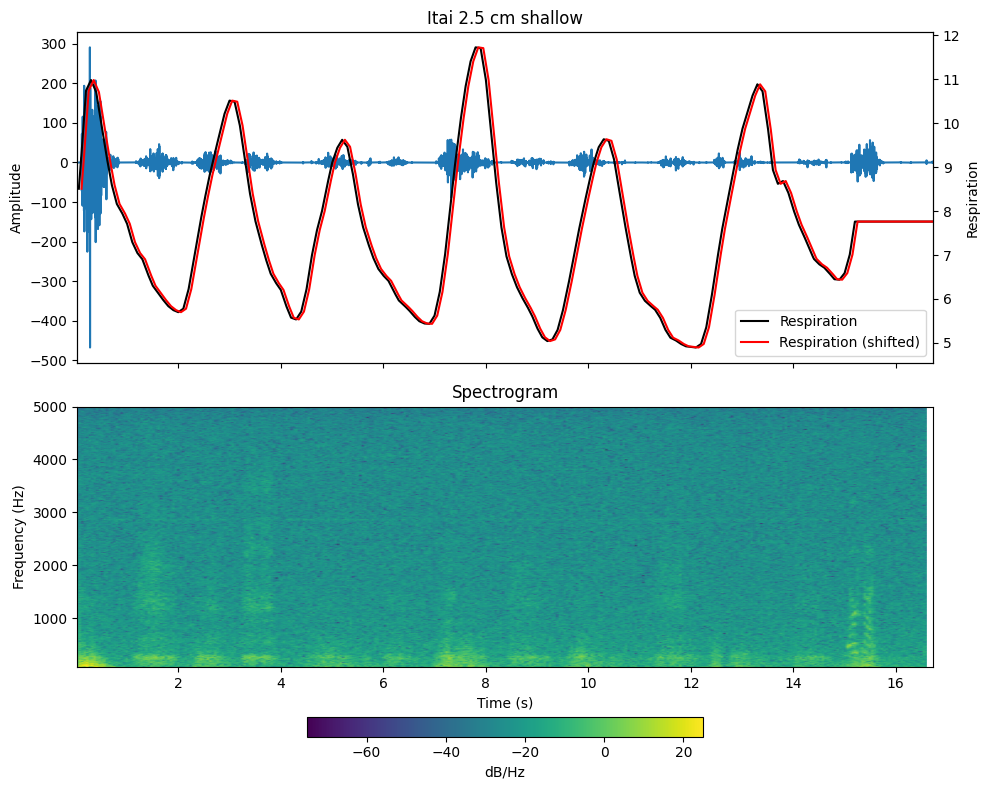

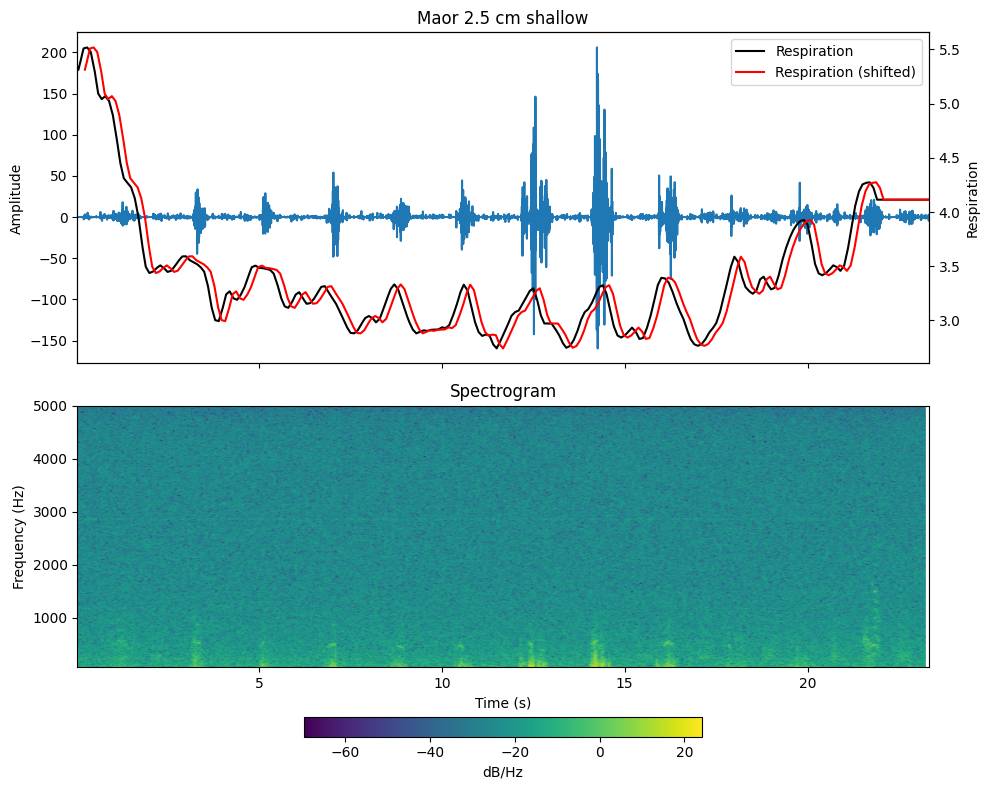

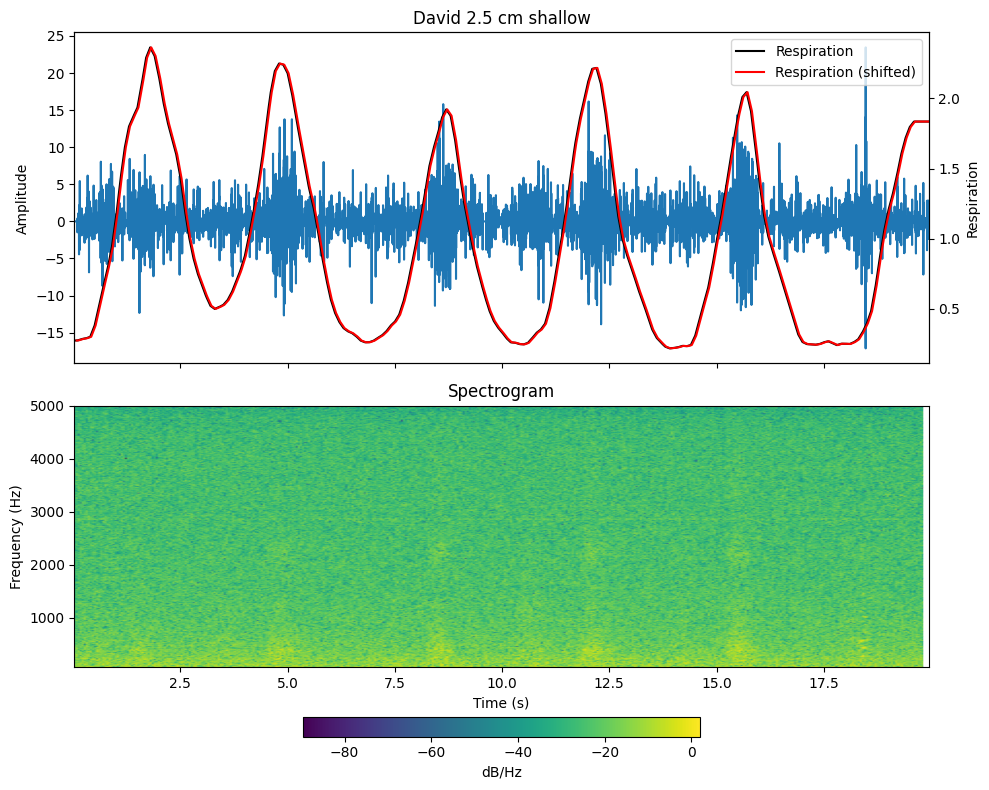

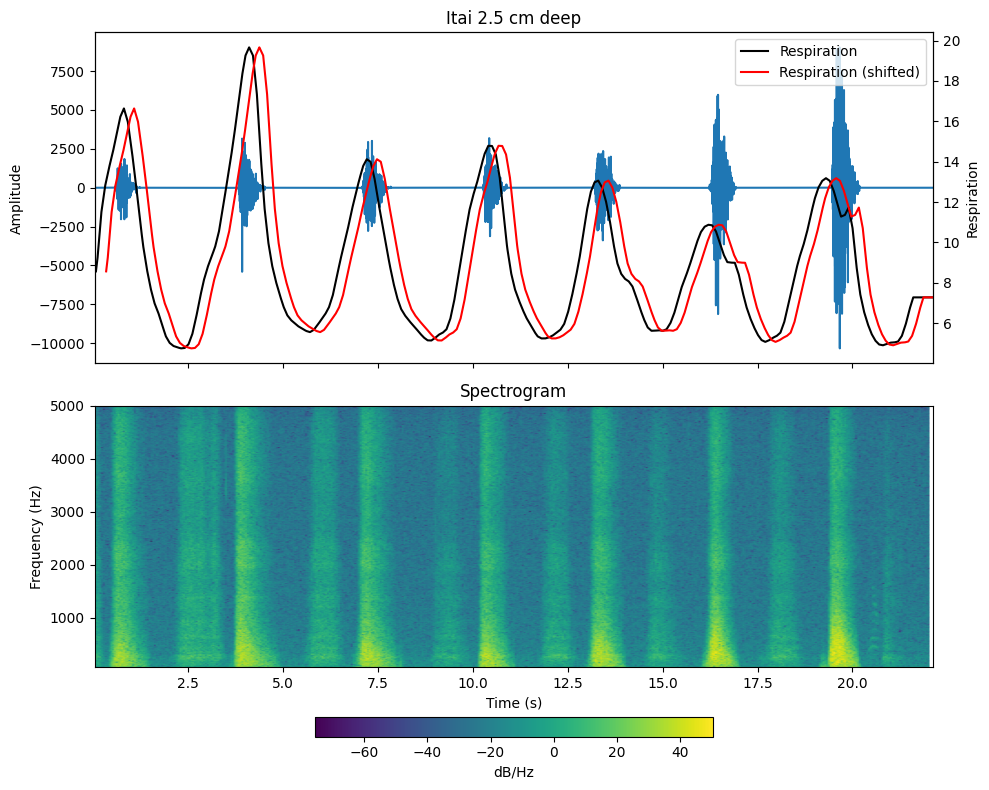

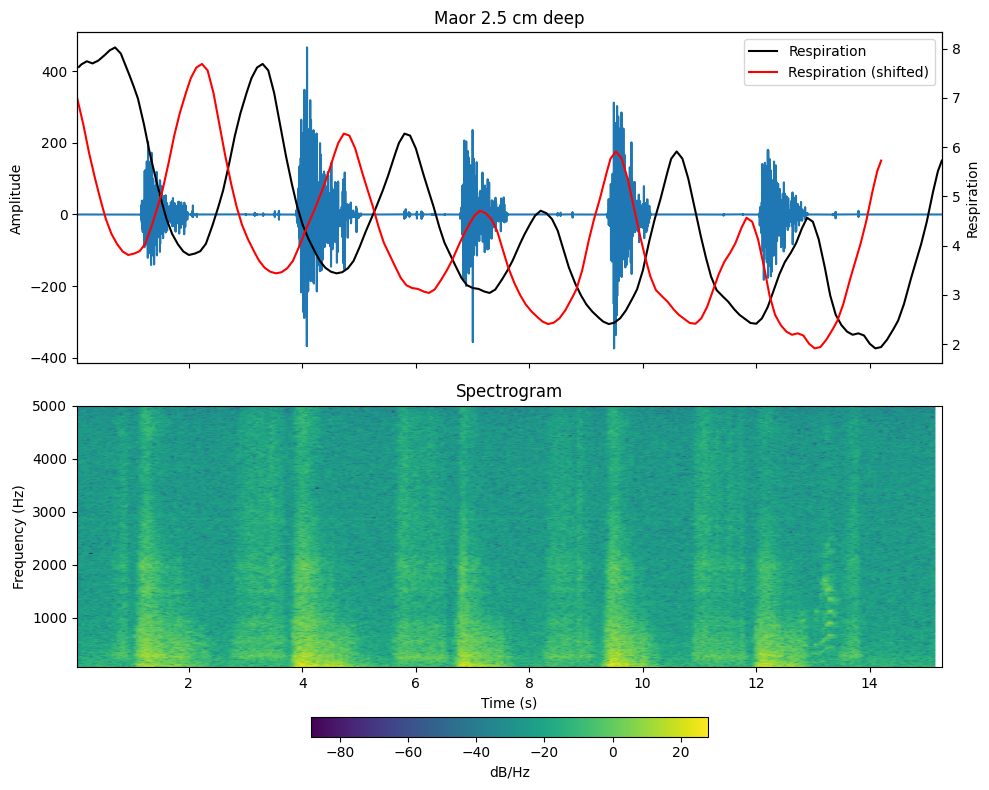

...

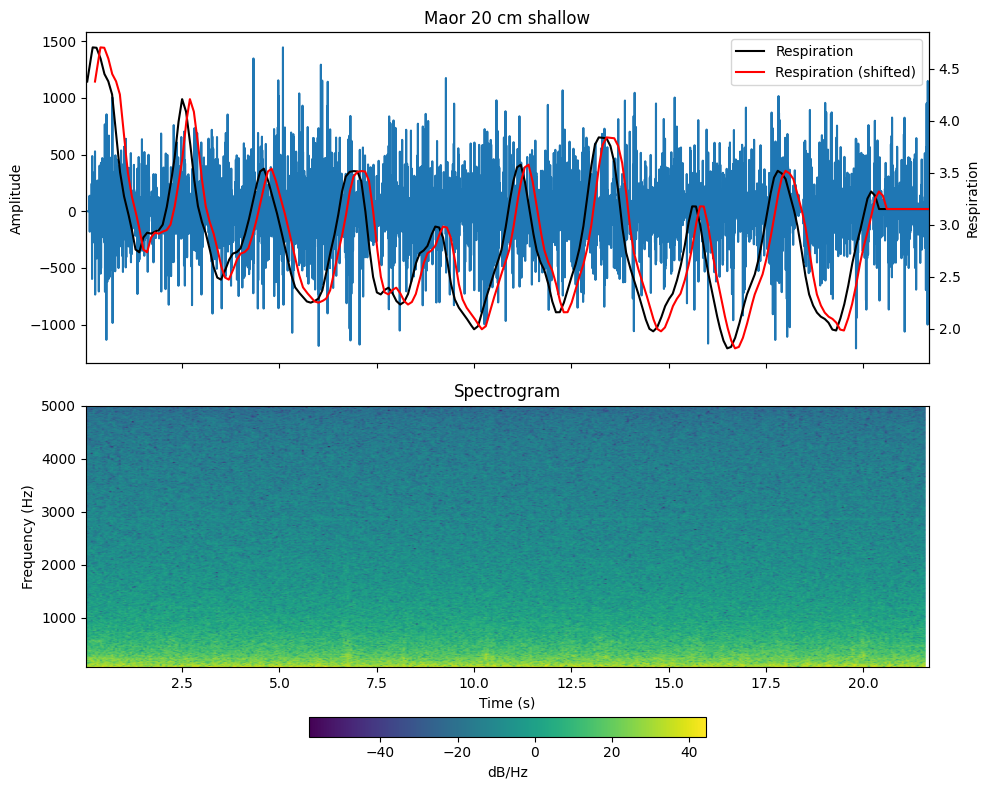

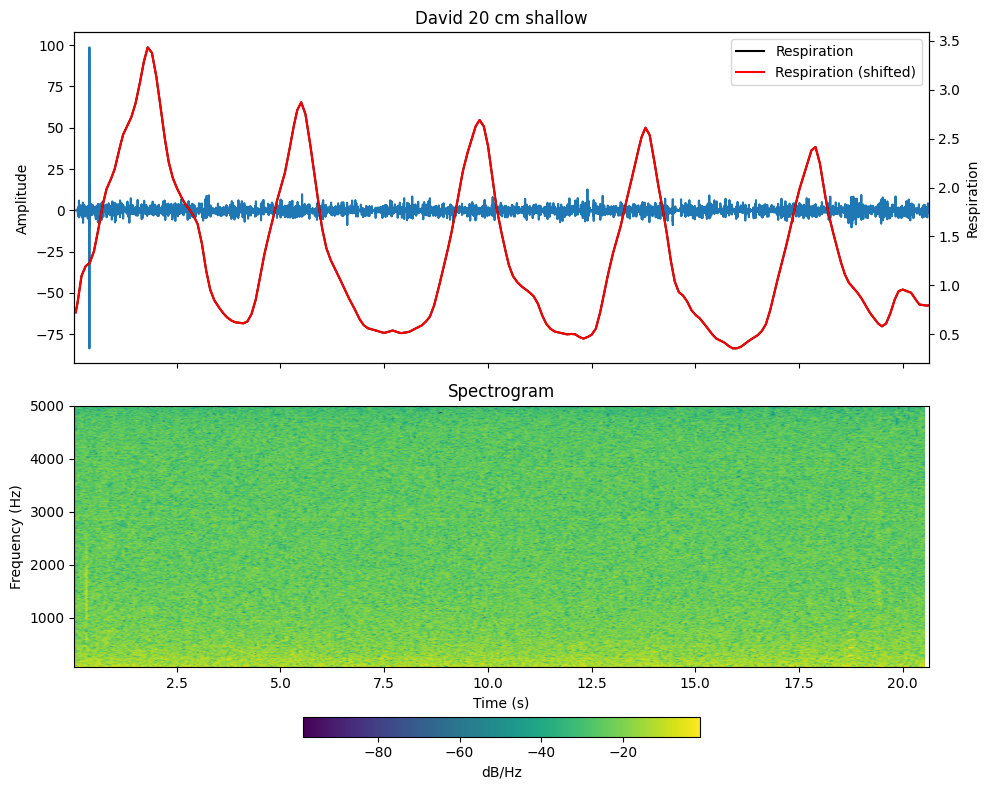

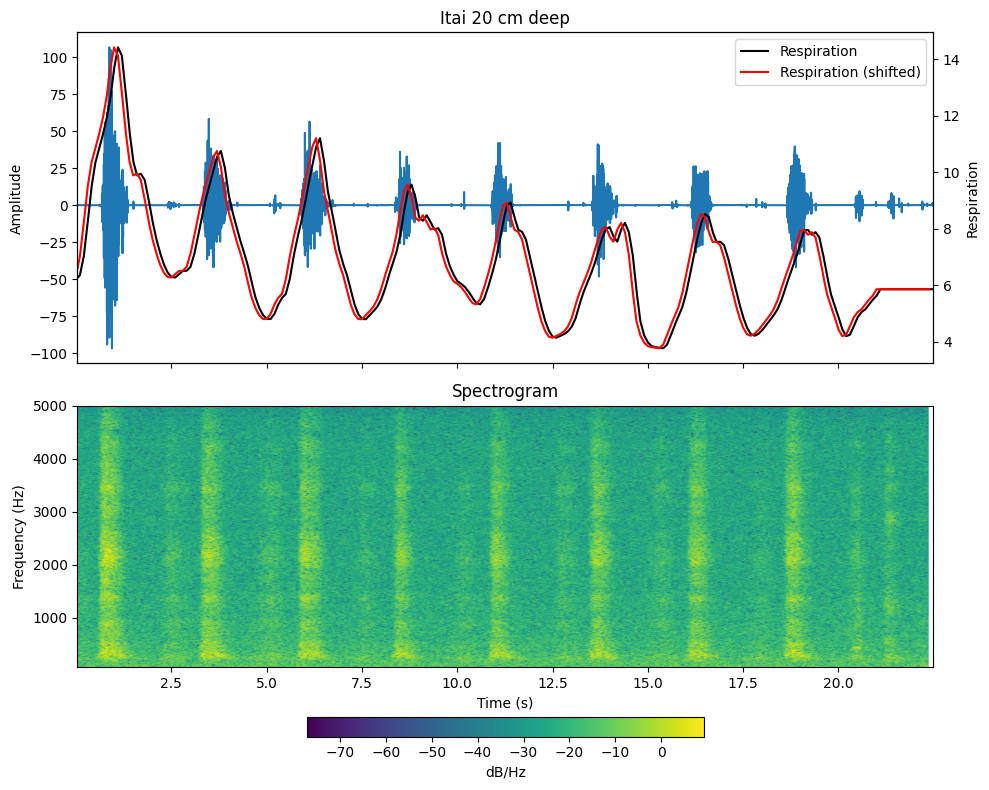

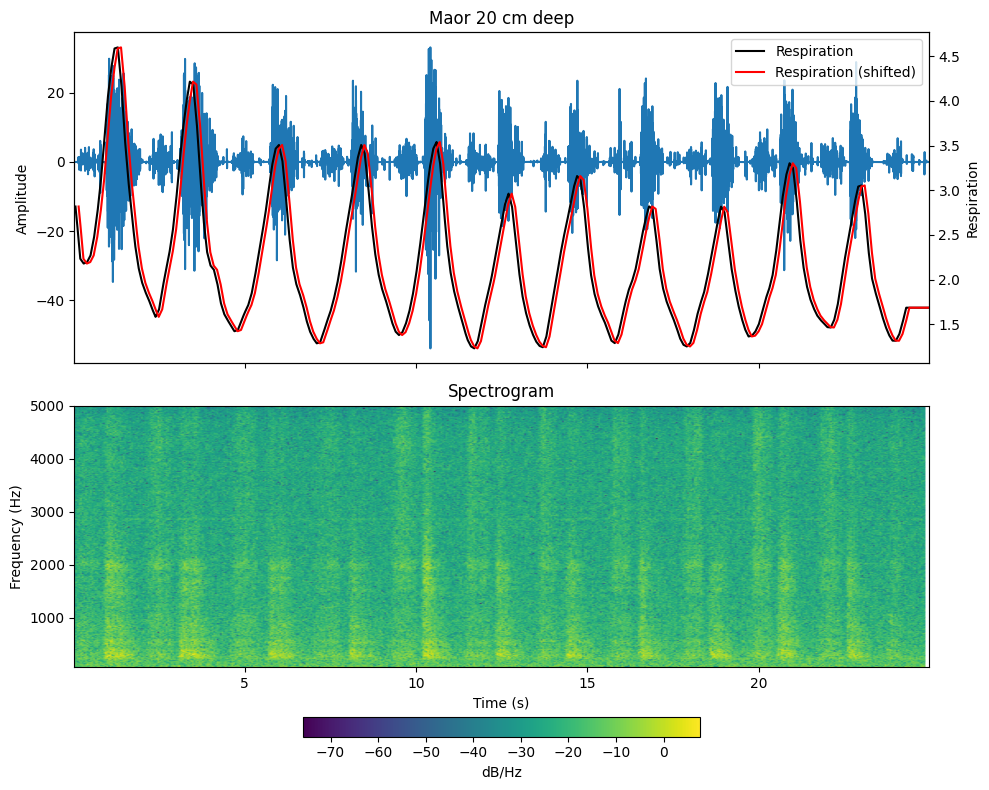

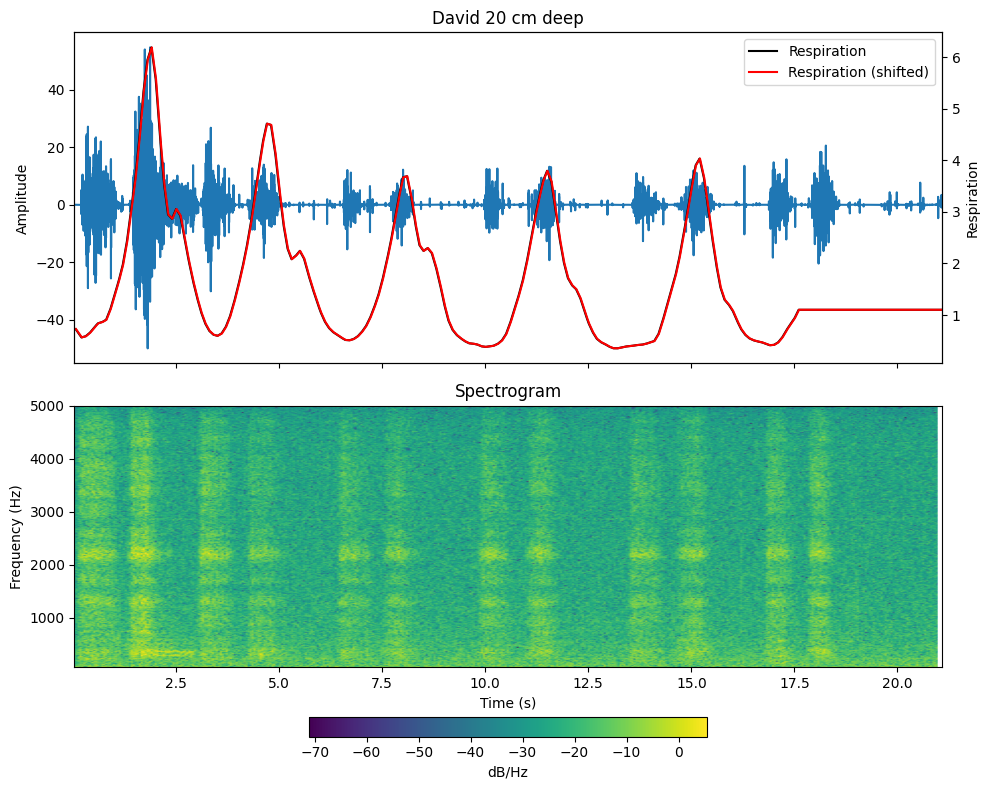

In [ ]:
subjects = ['Itai','Maor','David']
distances = [2.5,5,10,20]
resps = ['shallow','deep']

for distance, resp, subject in product(distances, resps, subjects):
  audio_df = audio_dict[subject][distance][resp][1000:]
  Title = f'{subject} {str(distance)} cm {resp}'

  x = audio_fig(audio_df,
                process_stage='filtered',
                fs=sampling_rate,
                title=Title,
                save_path=os.path.join(mounted_path, data_path, 'Figures'),
                nfft=1024,
                vmin=None,
                vmax=None,
                save=False
                )

In [ ]:
audio_df.raw_data

,raw_data
0,0
1,0
2,0
3,0
4,0
...,...
325286,-1
325287,0
325288,0
325289,0


In [ ]:
f = '/content/drive/MyDrive/Work/Sandra/SANDRA Main Folder/Sandra R&D/Data/Open Recordings /Second Pilot - acoustic room/Data/Itai/0_(2.5cm)/Itai_Shallow:2.5cm.m4a'
audio_data = audio_dataframe(f)

In [ ]:
audio = AudioSegment.from_file(f).set_frame_rate(16000)
raw_data = audio.raw_data

In [ ]:
snr['snr'] = snr['std']/snr['mean']
sn.lineplot(data=snr,x='Distance',y='snr',hue='Subject',style='Level')

## Choose Subject and Distance

In [ ]:
subject = 'Itai'
distance = 20
folders = os.listdir(os.path.join(mounted_path,data_path,subject))
folder = folders[[i for i in range(len(folders)) if '('+str(distance)+'cm)' in folders[i]][0]]
audio_files = glob(os.path.join(mounted_path,data_path,subject,folder,'*cm.m*'))
respiration_files = glob(os.path.join(mounted_path,data_path,subject,folder,'*.csv'))

### Shallow

In [ ]:
t = 'shallow'

af = [f for f in audio_files if t in f.split('\\')[-1].lower()][0]
rf = [f for f in respiration_files if t in f.split('\\')[-1].lower()][0]

print(af.split('/')[-1])
audio = AudioSegment.from_file(af)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)

time_v = np.arange(len(audio_array)) / sampling_rate
audio_data = pd.DataFrame({'time': time_v,'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} S/s, duration: {round(len(audio_data)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio


In [ ]:
respiration_data = pd.read_csv(rf)
print(rf.split('/')[-1])

sp = spectrogram(audio_data.iloc[:,1], title = ' '.join([subject,str(distance)+'cm',t]), save_path = os.path.join(mounted_path,data_path,'Figures'), nfft=1024, fs= sampling_rate,vmin=-30, vmax = -5,save=False)

# bandpass_filter(audio_data,lowcut = 70, highcut = 5000, fs = 48000, order = 6, notch = False, plot = True, xmax = 7500)
audio_data['filtered'] = bandpass_filter(audio_data['raw_data'],lowcut = 70, highcut = 5000, fs = sampling_rate, order = 6)
audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold = 99 )
audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs = sampling_rate, window_size=50, iterations=4)
audio_data['Respiration'] = np.interp(audio_data.time,respiration_data['Data Set 1:Time(s)'],respiration_data['Data Set 1:Force(N)'] )

plot_sig(audio_data.iloc[:,1:],sampling_rate,title = ' '.join([subject,str(distance)+'cm',t]), save_path = os.path.join(mounted_path,data_path,'Figures'),additional_df = respiration_data, figsize = (10,10),save=False)


In [ ]:
p,d = find_peaks(audio_data['wavelet_smoothed'],distance=sampling_rate/2, width = sampling_rate/4)
plt.plot(audio_data['wavelet_smoothed'])
plt.scatter(p,audio_data['wavelet_smoothed'][p])

In [ ]:
plt.plot(sp[2],sp[0].mean(axis=0))
np.std(sp[0].mean(axis=0))/np.mean(sp[0].mean(axis=0))

In [ ]:
import scipy.signal as sig
faxis,psX = sig.periodogram(audio_data['filtered'],fs=sampling_rate, window=('kaiser',38))
plt.plot(faxis,10*np.log10(psX))
plt.xlabel('Freq[Hz]')
plt.ylabel('power [dB]')

fundBin = np.argmax(psX) #estimate fundamental at maximum amplitude, get the bin number
faxis[fundBin]

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np


In [ ]:
audio_file = af
y, sr = librosa.load(audio_file)


In [ ]:
sr

In [ ]:
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)


In [ ]:
mfccs.shape

In [ ]:
plt.figure(figsize=(10, 5))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar(format='%+2.0f dB')
plt.title('MFCC')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficients')
plt.show()

plt.plot(sp[2],sp[0].mean(axis=0))

In [ ]:
import librosa.display
import ipywidgets as widgets
from IPython.display import display
from IPython.display import Audio
from scipy.fftpack import dct

# File uploader widget
uploader = widgets.FileUpload(accept='.wav', multiple=False)

# Load and compute MFCCs for a given audio file
def compute_mfcc(file):
    y, sr = librosa.load(file, sr=None)
    y_preemphasized = np.append(y[0], y[1:] - pre_emphasis * y[:-1])
    signal_length = len(y_preemphasized)
    num_frames = int(np.ceil(float(np.abs(signal_length - frame_length)) / frame_step))
    pad_signal_length = num_frames * frame_step + frame_length
    z = np.zeros((pad_signal_length - signal_length))
    pad_signal = np.append(y_preemphasized, z)
    indices = np.tile(np.arange(0, frame_length), (num_frames, 1)) + np.tile(np.arange(0, num_frames * frame_step, frame_step), (frame_length, 1)).T
    frames = pad_signal[indices.astype(np.int32, copy=False)]
    frames *= np.hamming(frame_length)
    mag_frames = np.absolute(np.fft.rfft(frames, NFFT))
    pow_frames = ((1.0 / NFFT) * ((mag_frames) ** 2))
    filter_banks = np.dot(pow_frames, fbank.T)
    filter_banks = np.where(filter_banks == 0, np.finfo(float).eps, filter_banks)
    filter_banks = 20 * np.log10(filter_banks)
    mfcc = dct(filter_banks, type=2, axis=1, norm='ortho')[:, :num_ceps]

    plt.figure(figsize=(14, 5))
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title('Waveform')
    plt.subplot(2, 1, 2)
    plt.imshow(mfcc.T, cmap='hot', aspect='auto')
    plt.title('MFCC')
    plt.xlabel('Frame Index')
    plt.ylabel('Cepstral Coefficient Index')
    plt.tight_layout()
    plt.show()

# Handle file upload and compute MFCCs
def on_upload_change(change):
    file = list(uploader.value.values())[0]
    compute_mfcc(file['content'])

uploader.observe(on_upload_change, names='value')

# Button to compute MFCCs for the sample audio file
sample_button = widgets.Button(description='Use Sample Audio')
def on_sample_button_click(b):
    compute_mfcc(sample_audio_path)

sample_button.on_click(on_sample_button_click)

# Display widgets
display(uploader, sample_button)


### Deep

In [ ]:
t = 'deep'

af = [f for f in audio_files if t in f.split('\\')[-1].lower()][0]
rf = [f for f in respiration_files if t in f.split('\\')[-1].lower()][0]

print(af.split('/')[-1])
audio = AudioSegment.from_file(af)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)
time_v = np.arange(len(audio_array)) / sampling_rate
audio_data = pd.DataFrame({'time': time_v,'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} S/s, duration: {round(len(audio_data)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio


In [ ]:
respiration_data = pd.read_csv(rf)
print(rf.split('/')[-1])

sp=spectrogram(audio_data.iloc[:,1], title = ' '.join([subject,str(distance)+'cm',t]), save_path = os.path.join(mounted_path,data_path,'Figures'), nfft=1024, fs= sampling_rate,vmin=-30, vmax = -5,save=False)

# bandpass_filter(audio_data,lowcut = 70, highcut = 5000, fs = 48000, order = 6, notch = False, plot = True, xmax = 7500)
audio_data['filtered'] = bandpass_filter(audio_data['raw_data'],lowcut = 70, highcut = 5000, fs = sampling_rate, order = 6)
audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold = 99 )
audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs = sampling_rate, window_size=50, iterations=4)
audio_data['Respiration'] = np.interp(audio_data.time,respiration_data['Data Set 1:Time(s)'],respiration_data['Data Set 1:Force(N)'] )

plot_sig(audio_data.iloc[:,1:],sampling_rate,title = ' '.join([subject,str(distance)+'cm',t]), save_path = os.path.join(mounted_path,data_path,'Figures'),additional_df = respiration_data, figsize = (10,10),save=False)


In [ ]:
fig, ax1 = plt.subplots() # initializes figure and plots

ax2 = ax1.twinx() # applies twinx to ax2, which is the second y axi

sn.lineplot(ax=ax1,data=audio_data,x='time',y='wavelet')
sn.lineplot(ax=ax2,data=audio_data,x='time',y='Respiration',color='Red')

In [ ]:
a=audio_data.wavelet.values
b=audio_data.Respiration.values
lag = np.min((np.abs(np.argmax(signal.correlate(a,b)) - a.shape[0]),np.abs(np.argmax(signal.correlate(b,a)) - a.shape[0])))
print(lag)

fig, ax1 = plt.subplots() # initializes figure and plots

ax2 = ax1.twinx() # applies twinx to ax2, which is the second y axi

sn.lineplot(ax=ax1,data=audio_data,x='time',y='wavelet')
sn.lineplot(ax=ax2,data=audio_data,x='time',y='Respiration',color='Black')

sn.lineplot(ax=ax2,x=audio_data.time-t[p[np.argmin(np.abs(t[p]))]],y=audio_data.Respiration,color='Red')

# sn.lineplot(ax=ax2,x=audio_data.iloc[:-lag,0].values,y=audio_data.iloc[lag:,-1].values,color='Green')

In [ ]:
t = np.arange(-a.shape[0],a.shape[0]-1)/sampling_rate
y = signal.correlate(b,a)
sn.lineplot(x=t,y=y)
from scipy.signal import find_peaks
p = find_peaks(y,distance=sampling_rate,width=sampling_rate/8)[0]
sn.scatterplot(x=t[p],y=y[p],color='red')

t[np.argmin(np.abs(t[p]))]

In [ ]:
plt.plot(sp[2],sp[0].mean(axis=0))
np.std(sp[0].mean(axis=0))/np.mean(sp[0].mean(axis=0))

In [ ]:
import scipy.signal as sig
faxis,psX = sig.periodogram(audio_data['raw_data'],fs=sampling_rate, window=('kaiser',38))
plt.plot(faxis,10*np.log10(psX))
plt.xlabel('Freq[Hz]')
plt.ylabel('power [dB]')

fundBin = np.argmax(psX) #estimate fundamental at maximum amplitude, get the bin number
faxis[fundBin]
# fundIndizes = getIndizesAroundPeak(ps,fundBin) #get bin numbers around fundamental peak
# fundFrequency = faxis[fundBin] #frequency of fundamental

# Analysis - Open Recordings

In [ ]:
mounted_path = '/content/drive/MyDrive/Sandra'
desktop_path = 'G:/.shortcut-targets-by-id/1T6epc5UaDCKw_p5Q0RLDJnlZeS5JSL9_'

data_path = 'Sandra R&D/Data/Open Recordings /JBL'

subjects = ['Or','Maor','Other']


In [ ]:
for subject in subjects:
    audio_files = glob(os.path.join(mounted_path,data_path,subject,'*.m4a'))
    print(audio_files)
    for af in audio_files[1:]:
      filename = '_'.join([subject,af.split('/')[-1].split('.')[0]])

      print(filename)
      audio = AudioSegment.from_file(af).set_frame_rate(32000)
      raw_data = audio.raw_data
      channels = audio.channels
      sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
      sampling_rate = audio.frame_rate

      audio_data = audio_dataframe(raw_data,sampling_rate)
      audio_data.to_csv(os.path.join(mounted_path, 'Sandra R&D/Data/Model Data',filename+'.csv' ))

      sp = spectrogram(audio_data.raw_data, title = filename, save_path = os.path.join(mounted_path,'Sandra R&D/Data','Figures'), nfft=1024, fs= sampling_rate,vmin=-30, vmax = -5, save=True)

      audio = AudioSegment.from_file(af).set_frame_rate(16000)
      raw_data = audio.raw_data
      channels = audio.channels
      sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
      sampling_rate = audio.frame_rate
      audio_data = audio_dataframe(raw_data,sampling_rate)
      plot_sig(audio_data.iloc[:,1:],sampling_rate,title = filename, save_path = os.path.join(mounted_path,'Sandra R&D/Data','Figures'),figsize = (10,10),save=True)





## David Deep 2.5 cm

In [ ]:
folder = '/content/drive/MyDrive/Sandra/Sandra R&D/Data/Open Recordings /Second Pilot - acoustic room/Data/David/2.5cm (5cm)/'
audio_file = 'David_Deep_5cm.m4a'
respiration_file = 'David_Deep_5cm - David_Deep_5cm.csv.csv'

audio_file_path = f'{folder}{audio_file}'
respiration_file_path = f'{folder}{respiration_file}'
respiration_data = pd.read_csv(respiration_file_path)

In [ ]:
audio = AudioSegment.from_file(audio_file_path)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)
audio_data = pd.DataFrame({'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} S/s, duration: {round(len(audio_data)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio

In [ ]:
audio_data.shape

In [ ]:
audio = audio.set_frame_rate(16000)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)
audio_data = pd.DataFrame({'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} S/s, duration: {round(len(audio_data)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio

In [ ]:
audio_data.shape

In [ ]:
plot_sig(audio_data,fs = sampling_rate, figsize = (10,3))

In [ ]:
spectrogram(audio_data.iloc[:,0], nfft=1024, fs= sampling_rate,vmin=-30, vmax = -5)

In [ ]:
ds_factor = 2
downsampled_audio = pd.DataFrame(decimate(audio_array, ds_factor, ftype='fir'),columns=['downsampled_audio'])
d_fs = sampling_rate / ds_factor

In [ ]:
audio_array.shape

In [ ]:
downsampled_audio.shape

In [ ]:
plot_sig(downsampled_audio,fs = d_fs, figsize = (10,3))

In [ ]:
spectrogram(downsampled_audio.iloc[:,0], fs= d_fs,vmin=-20, vmax = -5)

In [ ]:
def audio_track(audio, fs):
  track = audio.iloc[:,0].to_numpy()
  audio_segment = AudioSegment(
      track.tobytes(),
      frame_rate=fs,
      sample_width=4,
      channels=2
  )

  return audio_segment

ds= audio_track(downsampled_audio,d_fs)
ds

In [ ]:
ds.frame_rate

In [ ]:
bandpass_filter(audio_data,lowcut = 70, highcut = 5000, fs = 48000, order = 6, notch = False, plot = True, xmax = 7500)

In [ ]:
audio_data['filtered'] = bandpass_filter(audio_data['raw_data'],lowcut = 70, highcut = 5000, fs = sampling_rate, order = 6)
audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold = 99 )
audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs = sampling_rate, window_size=50, iterations=4)

In [ ]:
plot_sig(downsampled_audio,sampling_rate, additional_df = respiration_data, figsize = (10,10))

In [ ]:
spectrogram(audio_data['filtered'], fs=sampling_rate,vmin=-20, vmax = -5)

In [ ]:
spectrogram(audio_downsampled_wavelet, fs=desired_fs,vmin=-50, vmax = -5)

## David shallow 2.5 cm

In [ ]:
folder = '/content/drive/MyDrive/Work/Sandra/SANDRA Main Folder/Data/Second Pilot - acoustic room/Data/David/0 (2.5cm) /'
audio_file = 'david_shallow_2.5_cm.m4a'
respiration_file = 'david_shallow_2.5_cm_resp.csv'

audio_file_path = f'{folder}{audio_file}'
respiration_file_path = f'{folder}{respiration_file}'
respiration_data = pd.read_csv(respiration_file_path)

In [ ]:
audio = AudioSegment.from_file(audio_file_path)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)
audio_data = pd.DataFrame({'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} bits/s, duration: {round(len(audio_data)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio

In [ ]:
plot_sig(audio_data[['raw_data']],fs = sampling_rate, figsize = (10,3))

In [ ]:
bandpass_filter(audio_data,lowcut = 70, highcut = 5000, fs = 48000, order = 6, notch = True, plot = True, xmax = 8000)

In [ ]:
audio_data['filtered'] = bandpass_filter(audio_data['raw_data'],lowcut = 70, highcut = 5000, fs = sampling_rate, order = 6)
audio_data['wavelet'] = wavelet_denoising(audio_data['filtered'], wavelet='db4', level=5, threshold = 99 )
audio_data['wavelet_smoothed'] = smoothed_signal(audio_data['wavelet'], fs = sampling_rate, window_size=50, iterations=4)

In [ ]:
plot_sig(audio_data,sampling_rate, additional_df = respiration_data, figsize = (10,10))

In [ ]:
spectrogram(audio_data['raw_data'], fs=sampling_rate,vmin=-40, vmax = -10)

In [ ]:
spectrogram(audio_data['wavelet_smoothed'], fs=sampling_rate,vmin=-20, vmax = 5)

# New Section

In [ ]:
from scipy.io import wavfile
audio_data = data['wavelet'].values

# Normalize the audio samples to be between -1 and 1 (if needed)
max_abs = np.max(np.abs(audio_data))
audio_data_normalized = audio_data / max_abs
fs = sampling_rate
wavfile.write('wavelet.wav', fs, audio_data_normalized.astype(np.float32))


In [ ]:
audio_data = data['raw_data'].values

# Normalize the audio samples to be between -1 and 1 (if needed)
max_abs = np.max(np.abs(audio_data))
audio_data_normalized = audio_data / max_abs
fs = sampling_rate
wavfile.write('raw_data.wav', fs, audio_data_normalized.astype(np.float32))

# Or Open recordings

In [ ]:
folder = '/content/drive/MyDrive/Work/Sandra/SANDRA Main Folder/Sandra R&D/Data/Open Recordings /JBL/Or/'
audio_file = 'Recording 1.m4a'
#respiration_file = 'David_Deep_5cm - David_Deep_5cm.csv.csv'

audio_file_path = f'{folder}{audio_file}'
#respiration_file_path = f'{folder}{respiration_file}'
#respiration_data = pd.read_csv(respiration_file_path)

In [ ]:
audio = AudioSegment.from_file(audio_file_path)
raw_data = audio.raw_data
channels = audio.channels
sample_width = audio.sample_width # sample resolution = sample_width X 8 (1 = 8bit, 2 = 16 bit etc.)
sampling_rate = audio.frame_rate
audio_array = np.frombuffer(raw_data, dtype=np.int16)
#audio_data = pd.DataFrame({'raw_data': audio_array})

print(f'Recored parameters: {channels} ch, {sample_width * 8} bits, {sampling_rate} bits/s, duration: {round(len(audio_array)/sampling_rate,3)} seconds')
print('_______________________________________________')
audio

Recored parameters: 1 ch, 16 bits, 48000 bits/s, duration: 1081.152 seconds
_______________________________________________


In [ ]:
from scipy.signal import resample_poly
down = 3
audio_array_float = audio_array.astype(np.float32) / np.max(np.abs(audio_array))
audio_ds = resample_poly(audio_array_float, up=1, down=down)
audio_ds_df = pd.DataFrame({'raw_data': audio_ds})
ds_rate = int(sampling_rate/down)
ds_rate

16000

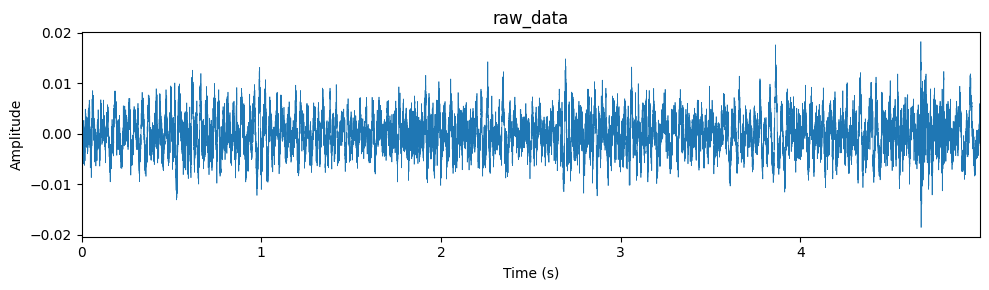

In [ ]:
start = 60
duration = 5
data = audio_ds_df[start*ds_rate:(start+duration)*ds_rate]
plot_sig(data,fs = ds_rate, figsize = (10,3),title = '')

In [ ]:
audio_data.nk = nr.reduce_noise(y=data, sr=sampling_rate)

KeyboardInterrupt: 